## **Notebook #6**
## Simple Recurrent Neural Network, Linear Predictor, MLP, ESN and LSTM for multi-step time series prediction.
**Professor:** Fernando J. Von Zuben <br>
**Aluno(a):** Arthur Felipe dos Santos Fernandes


In [28]:
# Loading all the relevant libraries
from pandas import read_csv
from pandas import DataFrame
import numpy as np
import pandas as pd
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, SimpleRNN, LSTM, GRU
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
import math
import matplotlib.pyplot as plt

## **A base [unemployment rate] foi baixada no [link](https://fred.stlouisfed.org/series/UNRATE).**

In [30]:
# Structuring the dataset from a single time series, scaling and spliting into training / testing
def get_train_test(dataset, split_percent, time_steps, horizon):
    df = read_csv(dataset, usecols=[1], engine='python')
    data = np.array(df.values.astype('float32'))
    scaler = MinMaxScaler(feature_range=(0, 1))
    # There is a kind of data leakage in the next command
    data = scaler.fit_transform(data).flatten()
    n = len(data)
    df = DataFrame()
    for i in range(0,time_steps):
      df['t-' + str(time_steps-i-1)] = [data[j] for j in range(i, (len(data)-horizon-time_steps+i+1))]
    for i in range(1,horizon+1):
      df['t+' + str(i)] = [data[j] for j in range(time_steps+i-1, (len(data)-horizon+i))]
    print(df)
    df1 = df.copy()
    for i in range(1,horizon+1):
      df1 = df1.drop(['t+' + str(i)], axis = 1)
    dataX = np.array(df1)
    df2 = df['t+1']
    for i in range(2,horizon+1):
      df2 = pd.concat([df2, df['t+' + str(i)]], axis=1)
    datay = np.array(df2)
    # Point for splitting data into train and test
    split = int(n*split_percent)
    X = dataX[range(split),:]
    y = datay[range(split)]
    Xt = dataX[split:,:]
    yt = datay[split:]
    return X, y, Xt, yt

time_steps = 11
horizon = 3
# Here you will decide which dataset to consider.
dataset = [get_train_test('unemployment_rate.csv', 0.8, time_steps, horizon), 
get_train_test('monthly_sunspot.csv', 0.8, time_steps, horizon)]
title = ['unemployment_rate', 'monthly_sunspot']

         t-10       t-9       t-8       t-7       t-6       t-5       t-4  \
0    0.073770  0.106557  0.122951  0.114754  0.081967  0.090164  0.090164   
1    0.106557  0.122951  0.114754  0.081967  0.090164  0.090164  0.114754   
2    0.122951  0.114754  0.081967  0.090164  0.090164  0.114754  0.106557   
3    0.114754  0.081967  0.090164  0.090164  0.114754  0.106557  0.098361   
4    0.081967  0.090164  0.090164  0.114754  0.106557  0.098361  0.106557   
..        ...       ...       ...       ...       ...       ...       ...   
873  0.360656  0.344262  0.344262  0.319672  0.303279  0.286885  0.286885   
874  0.344262  0.344262  0.319672  0.303279  0.286885  0.286885  0.270492   
875  0.344262  0.319672  0.303279  0.286885  0.286885  0.270492  0.278689   
876  0.319672  0.303279  0.286885  0.286885  0.270492  0.278689  0.237705   
877  0.303279  0.286885  0.286885  0.270492  0.278689  0.237705  0.221311   

          t-3       t-2       t-1       t-0       t+1       t+2       t+3  

In [19]:
# Recurrent Neural Networkd]
def create_RNN(X, y, time_steps, horizon):
  model = Sequential()
  model.add(SimpleRNN(units=30, activation='tanh', input_shape=(time_steps,1)))
  model.add(Dense(units=horizon, activation='tanh'))
  model.compile(loss='mean_squared_error', optimizer='adam')
  train_predict = model.fit(X, y, epochs=20, batch_size=1, verbose=2)
  return model

In [4]:
# Linear
def create_Linear(X, y, time_steps, horizon):
  model = LinearRegression()
  train_predict = model.fit(X, y)
  print(model.coef_)
  print(model.intercept_)
  return model

In [5]:
#  Multilayer Perceptron
def create_MLP(X, y, time_steps, horizon):
  model = tf.keras.models.Sequential([
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(80, activation=tf.nn.tanh),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(horizon, activation='linear')
  ])
  model.compile(optimizer='adam', loss='mean_squared_error')
  train_predict = model.fit(X, y, epochs=100)
  model.summary()
  return model

In [6]:
!git clone https://github.com/cknd/pyESN.git
!cp /content/pyESN/pyESN.py .
from pyESN import ESN
def create_ESN(X, y, time_steps, horizon):
  model = ESN(n_inputs = time_steps,
            n_outputs = horizon,
            n_reservoir = 500,
            spectral_radius = 2,
            random_state=42)
  model.fit(X,y)
  return model

fatal: destination path 'pyESN' already exists and is not an empty directory.
'cp' n�o � reconhecido como um comando interno
ou externo, um programa oper�vel ou um arquivo em lotes.


In [7]:
# LSTM
def create_LSTM(X, y, time_steps, horizon):
  X1 = X.reshape(X.shape[0],time_steps,1)
  model=Sequential()
  model.add(LSTM(25,input_shape=(time_steps,1)))
  model.add(Dense(horizon,activation='linear'))
  model.compile(loss='mean_squared_error',optimizer='adam')

  train_predict = model.fit(X1,y,epochs=100,verbose=2)
  print(model.summary())
  return model

In [26]:
def erro(model, X, y, Xt, yt, horizon):
  def print_error(trainY, testY, train_predict, test_predict,i):    
      # Error of predictions
      train_rmse = math.sqrt(mean_squared_error(trainY, train_predict))
      test_rmse = math.sqrt(mean_squared_error(testY, test_predict))
      # Print RMSE
      print('t+%d RMSE train: %.3f RMSE' % (i+1, train_rmse))
      print('t+%d RMSE test: %.3f RMSE' % (i+1, test_rmse))

  # Make predictions
  train_predict = model.predict(X)
  test_predict = model.predict(Xt)

  for i in range(horizon):
    if(horizon == 1):
      y1_pred = train_predict
      y1_pred_t = test_predict
      y1 = y
      y1_t = yt
    elif(horizon > 1):
      y1_pred = train_predict[:,i]
      y1_pred_t = test_predict[:,i]
      y1 = y[:,i]
      y1_t = yt[:,i]
    print_error(y1, y1_t, y1_pred, y1_pred_t,i)
    # Plot the predictions together with the actual values
    
  def plot_result(trainY, testY, train_predict, test_predict,i):
      actual = np.append(trainY, testY)
      predictions = np.append(train_predict, test_predict)
      rows = len(actual)
      print('Predições e valores reais')
      plt.figure(figsize=(30, 6), dpi=300)
      plt.plot(range(rows), actual)
      plt.plot(range(rows), predictions)
      plt.axvline(x=len(trainY), color='r')
      plt.legend(['Actual', 'Predictions'])
      plt.xlabel('Time steps')
      plt.ylabel('Actual and Predicted Values')
      plt.title('t+%d Predition (The Red Line Separates The Training And Test Examples)' % (i+1))
      plt.grid(True)

  for i in range(horizon):
    if(horizon == 1):
      y1_pred = train_predict
      y1_pred_t = test_predict
      y1 = y
      y1_t = yt
    elif(horizon > 1):
      y1_pred = train_predict[:,i]
      y1_pred_t = test_predict[:,i]
      y1 = y[:,i]
      y1_t = yt[:,i]
    plot_result(y1, y1_t, y1_pred, y1_pred_t,i)
    # Plot the prediction error
  def plot_result2(trainY, testY, train_predict, test_predict,i):
      actual = np.append(trainY, testY)
      predictions = np.append(train_predict, test_predict)
      rows = len(actual)
      print('Erro de predição')
      plt.figure(figsize=(30, 6), dpi=300)
      plt.plot(range(rows), actual - predictions)
      plt.axvline(x=len(trainY), color='r')
      plt.xlabel('Time steps')
      plt.ylabel('Actual minus Predicted Values')
      plt.title('t+%d Predition Error (The Red Line Separates The Training And Test Examples)' % (i+1))
      plt.ylim(-0.5, +1.0) # Please, set the interval appropriately, considering all the graphs.
      plt.grid(True)

  for i in range(horizon):
    if(horizon == 1):
      y1_pred = train_predict
      y1_pred_t = test_predict
      y1 = y
      y1_t = yt
    elif(horizon > 1):
      y1_pred = train_predict[:,i]
      y1_pred_t = test_predict[:,i]
      y1 = y[:,i]
      y1_t = yt[:,i]
    plot_result2(y1, y1_t, y1_pred, y1_pred_t,i)

In [49]:
model = [[], []]
for ite, data in enumerate(dataset):
    X, y, Xt, yt = data
    model[ite] = [create_RNN(X, y, time_steps, horizon), create_Linear(X, y, time_steps, horizon),
           create_MLP(X, y, time_steps, horizon), create_ESN(X, y, time_steps, horizon),
           create_LSTM(X, y, time_steps, horizon)]

Epoch 1/20
712/712 - 2s - loss: 0.0038 - 2s/epoch - 2ms/step
Epoch 2/20
712/712 - 1s - loss: 0.0010 - 976ms/epoch - 1ms/step
Epoch 3/20
712/712 - 1s - loss: 8.6353e-04 - 957ms/epoch - 1ms/step
Epoch 4/20
712/712 - 1s - loss: 8.3608e-04 - 970ms/epoch - 1ms/step
Epoch 5/20
712/712 - 1s - loss: 7.6779e-04 - 923ms/epoch - 1ms/step
Epoch 6/20
712/712 - 1s - loss: 7.5494e-04 - 945ms/epoch - 1ms/step
Epoch 7/20
712/712 - 1s - loss: 7.4011e-04 - 927ms/epoch - 1ms/step
Epoch 8/20
712/712 - 1s - loss: 7.4558e-04 - 967ms/epoch - 1ms/step
Epoch 9/20
712/712 - 1s - loss: 7.2067e-04 - 948ms/epoch - 1ms/step
Epoch 10/20
712/712 - 1s - loss: 7.1520e-04 - 962ms/epoch - 1ms/step
Epoch 11/20
712/712 - 1s - loss: 7.0374e-04 - 927ms/epoch - 1ms/step
Epoch 12/20
712/712 - 1s - loss: 7.3195e-04 - 960ms/epoch - 1ms/step
Epoch 13/20
712/712 - 1s - loss: 6.8702e-04 - 946ms/epoch - 1ms/step
Epoch 14/20
712/712 - 1s - loss: 7.2202e-04 - 934ms/epoch - 1ms/step
Epoch 15/20
712/712 - 1s - loss: 7.2902e-04 - 934ms/ep

Dataset  unemployment_rate
6/6 [==============================] - 0s 2ms/step
t+1 RMSE train: 0.018 RMSE
t+1 RMSE test: 0.069 RMSE
t+2 RMSE train: 0.024 RMSE
t+2 RMSE test: 0.097 RMSE
t+3 RMSE train: 0.030 RMSE
t+3 RMSE test: 0.115 RMSE
Predições e valores reais
Predições e valores reais
Predições e valores reais
Erro de predição
Erro de predição
Erro de predição
t+1 RMSE train: 0.016 RMSE
t+1 RMSE test: 0.077 RMSE
t+2 RMSE train: 0.022 RMSE
t+2 RMSE test: 0.115 RMSE
t+3 RMSE train: 0.029 RMSE
t+3 RMSE test: 0.142 RMSE
Predições e valores reais
Predições e valores reais
Predições e valores reais
Erro de predição
Erro de predição
Erro de predição
6/6 [==============================] - 0s 800us/step
t+1 RMSE train: 0.023 RMSE
t+1 RMSE test: 0.083 RMSE
t+2 RMSE train: 0.028 RMSE
t+2 RMSE test: 0.118 RMSE
t+3 RMSE train: 0.032 RMSE
t+3 RMSE test: 0.139 RMSE
Predições e valores reais
Predições e valores reais
Predições e valores reais
Erro de predição
Erro de predição
Erro de predição
t+1 R

C:\Users\Ploita\AppData\Local\Temp\ipykernel_6156\1985387650.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(30, 6), dpi=300)


6/6 [==============================] - 0s 4ms/step
t+1 RMSE train: 0.018 RMSE
t+1 RMSE test: 0.089 RMSE
t+2 RMSE train: 0.025 RMSE
t+2 RMSE test: 0.118 RMSE
t+3 RMSE train: 0.032 RMSE
t+3 RMSE test: 0.142 RMSE
Predições e valores reais
Predições e valores reais
Predições e valores reais
Erro de predição
Erro de predição
Erro de predição
Dataset  monthly_sunspot
18/18 [==============================] - 0s 1ms/step
t+1 RMSE train: 0.059 RMSE
t+1 RMSE test: 0.080 RMSE
t+2 RMSE train: 0.067 RMSE
t+2 RMSE test: 0.093 RMSE
t+3 RMSE train: 0.072 RMSE
t+3 RMSE test: 0.103 RMSE
Predições e valores reais
Predições e valores reais
Predições e valores reais
Erro de predição
Erro de predição
Erro de predição
t+1 RMSE train: 0.058 RMSE
t+1 RMSE test: 0.073 RMSE
t+2 RMSE train: 0.067 RMSE
t+2 RMSE test: 0.087 RMSE
t+3 RMSE train: 0.071 RMSE
t+3 RMSE test: 0.093 RMSE
Predições e valores reais
Predições e valores reais
Predições e valores reais
Erro de predição
Erro de predição
Erro de predição
18/18 [

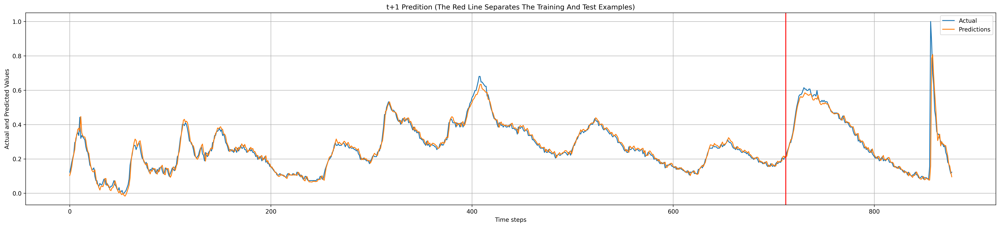

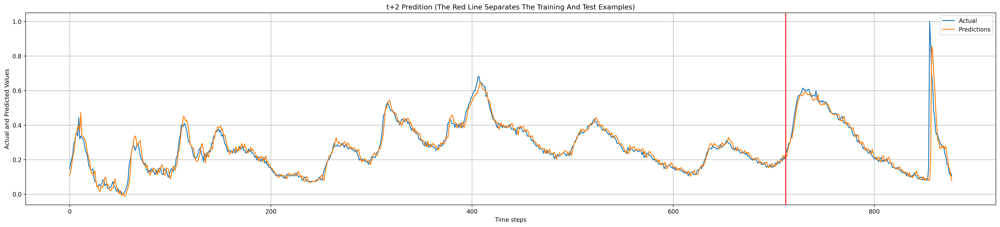

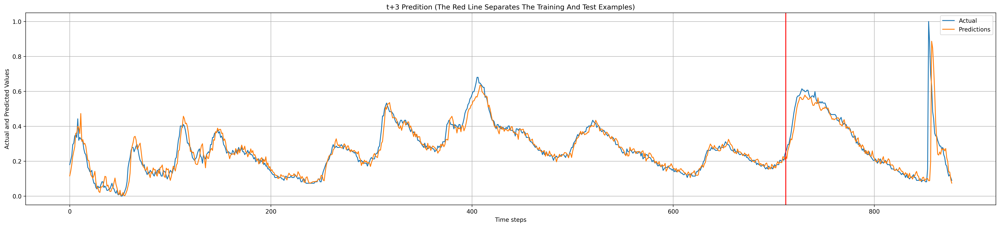

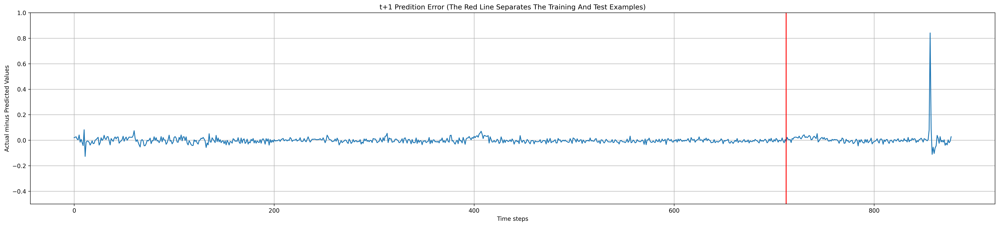

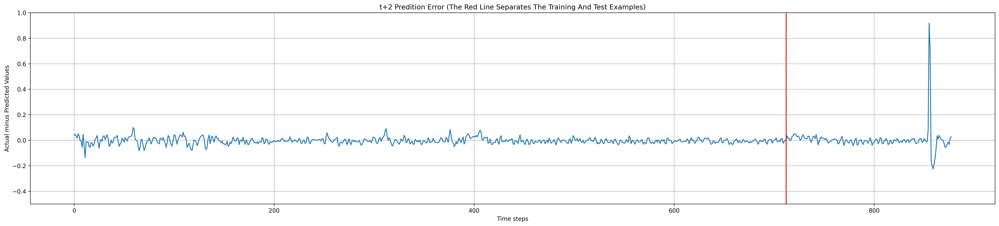

...

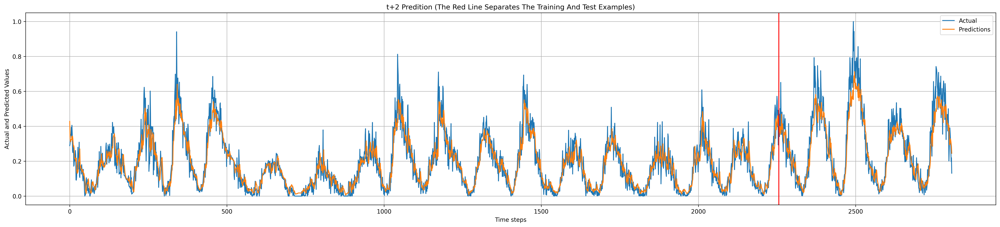

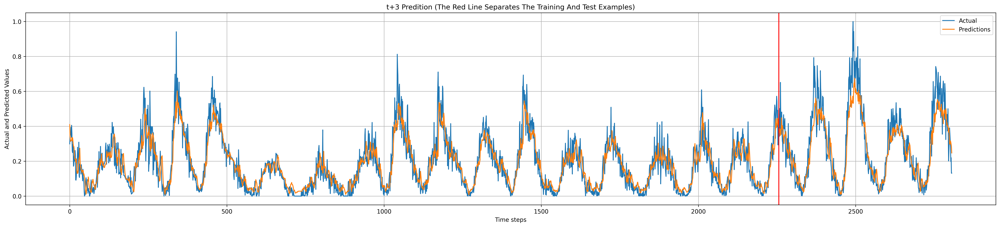

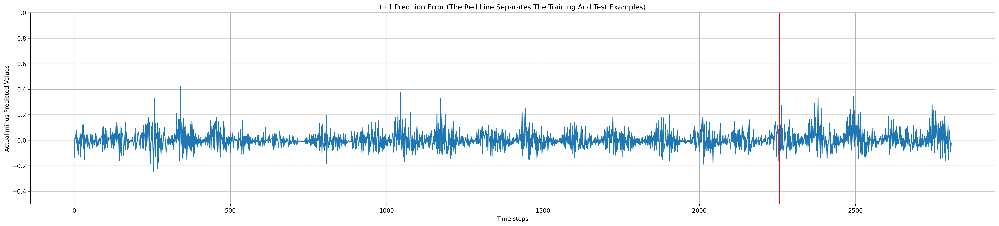

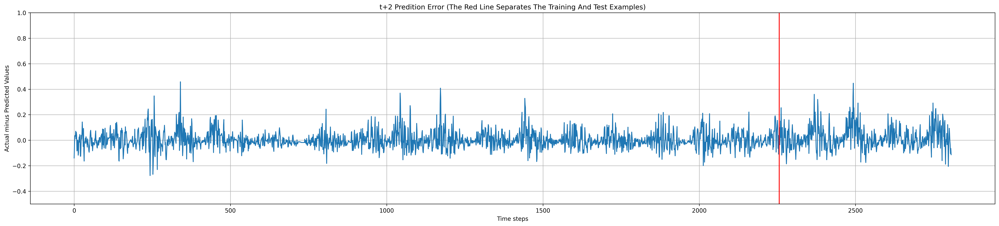

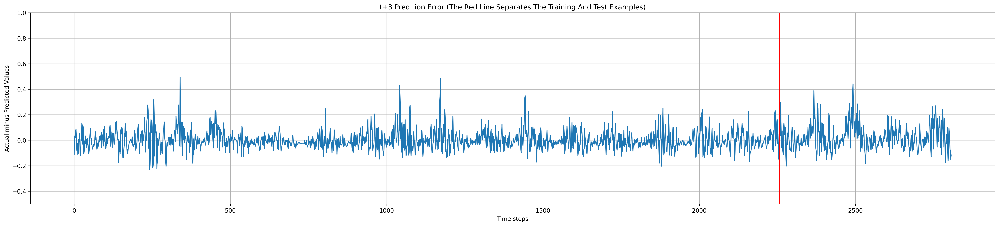

In [51]:
for ite, data in enumerate(dataset):
    print('Dataset ', title[ite])
    X, y, Xt, yt = data
    for modelo in model[ite]:
        erro(modelo, X, y, Xt, yt, horizon)